# connect to gdrive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [ ]:
#zining
%cd /content/gdrive/MyDrive/SUTD/IRProject/

/content/gdrive/MyDrive/SUTD/IRProject


In [ ]:
#luna
%cd /content/gdrive/MyDrive/IRProject/

/content/gdrive/.shortcut-targets-by-id/1ahfDdtcWq7L8op5-LpskyGKUqMpP6xZt/IRProject


# install anvil

In [ ]:
!pip install anvil-uplink

     |████████████████████████████████| 62 kB 770 kB/s 
     |████████████████████████████████| 51 kB 189 kB/s 
  Created wheel for ws4py: filename=ws4py-0.5.1-py3-none-any.whl size=45229 sha256=9a387ad7dcb103347d697cccba0725c96b6eae775c5464a902227441b72c1246
  Stored in directory: /root/.cache/pip/wheels/29/ea/7d/3410aa0aa0e4402ead9a7a97ab2214804887e0f5c2b76f0c96
Successfully built ws4py


# Functions

In [ ]:
import pandas as pd
from ast import literal_eval
import time
from collections import OrderedDict, Counter
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
from nltk.corpus import stopwords
from textblob import TextBlob, Word

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


In [ ]:
import re
def no_punc(s):
    return re.sub("\W", " ", s).lower()

In [ ]:
stop_words = set(stopwords.words('english'))

def tokenize(ingredients_ls):
  recipe = []
  for ingre in ingredients_ls:
    ing = no_punc(ingre).split()
    recipe += ing
  ingre_lemma = []
  for word in recipe:
    w = Word(word)
    w_lemma = w.lemmatize()
    ingre_lemma.append(w_lemma)
  word_list = [word for word in ingre_lemma if word not in stop_words if not word.isdigit() if word != " "]
  return word_list

In [ ]:
print(tokenize(['apple cider', '2% milk', 'half-and-half', 'ducks']))

['apple', 'cider', 'milk', 'half', 'half', 'duck']


## Connection to database

In [ ]:
import sqlite3

In [ ]:
def create_connection(db_file):
    """ create a database connection to the SQLite database
        specified by the db_file
    :param db_file: database file
    :return: Connection object or None
    """
    conn = None
    try:
        conn = sqlite3.connect(db_file)
    except Error as e:
        print(e)

    return conn

# query retrieval



In [ ]:
def getQuery (userInput):
    userInput = userInput.lower().strip().split()
    cleanInput = []
    for x in userInput:
        x = x.strip(",.()&")
        cleanInput.append(x)
    cleanInput = tokenize(cleanInput)
    return cleanInput

def QueryRetrieval(cleanInput,inv_sorted):
    doc_list = []
    matching_recipe = []
    for i in range(len(cleanInput)):
        if cleanInput[i] in inv_sorted:
            matching_recipe = inv_sorted.get(cleanInput[i])
            doc_list.append(literal_eval(matching_recipe))

    total_doc_id_list = []
    for j in range(len(doc_list)):
        total_doc_id_list += doc_list[j]
    return (total_doc_id_list)
    print (total_doc_id_list)

In [ ]:
getQuery("baker's acorns")

['baker', 'acorn']

# BM25

In [ ]:
import anvil.server
import math
from collections import Counter

In [ ]:
'''
A: Calculate TF
Given a tokenized document (a list of words), return a dictionary
with key as a word and value as the number of times it occurs in the doc. For
instance:
input: ['a', 'b', 'b', 'c', 'd']
output: {'a': 1, 'b': 2, 'c': 1, 'd': 1}
'''
def tf_(doc):
  frequencies = {}
  for term in doc:
    term_count = frequencies.get(term, 0) + 1
    frequencies[term] = term_count
  return frequencies

# connect to anvil webapp

In [ ]:
# length of docs
conn = create_connection("recipes.sqlite")
cur = conn.cursor()
r=cur.execute("select count(*) from RAW_recipes").fetchone()
doc_len = r[0] # >>> 231636
doc_len 

231636

In [ ]:
sum_dflen = cur.execute("SELECT SUM(doc_freq) FROM doc_freq").fetchone()
sum_dflen #>>> 11792806
avg_doc_len = sum_dflen[0]/doc_len

In [ ]:
check_invidx = cur.execute('select * from inverted_index').fetchall()
# len 4242 (old)
# new len is 3754 
# check_invidx[0][1]
invidx_dict = dict(check_invidx)

In [ ]:
# connect to webapp
anvil.server.connect('IDB6GE22DCR7MSYDBGU3FL76-3D63DXIVS3KTDKG3')

Connecting to wss://anvil.works/uplink
Anvil websocket open
Connected to "Default environment (dev)" as SERVER


In [ ]:
#this cell will keep running to be able to retrive info
# @anvil.server.callable
def predict_recipe_final(ingred):
  k1=1.5
  b=0.75
  retrieved_recipes=[]
  startt=time.time()

  # database connection --> needs a new one inside this function if not anvil doesnt work
  conn3 = create_connection("recipes.sqlite")
  cur3 = conn3.cursor()
  
  # STEP 1: Get user input (MISSING: PREPROCESS QUERY to match corpus-->ingredients/steps)
  cleanInput = getQuery(ingred)
  print("Input:",cleanInput)

  # STEP 2: Retrieve Relevant Docs
  rel_docs = QueryRetrieval(cleanInput,invidx_dict)
  # print("relevant docs retrived:",rel_docs)
  rel_docs_cleaned = tf_(rel_docs) # combine the retrieved docs to remove duplicates. Eg. [doc1,doc4,doc4,doc5] --> {doc1:1,doc4:2,doc5:1}
  len_retreived = len(rel_docs_cleaned)
  print("Retreived docs: ",len_retreived)
  if len_retreived == 0:
    return 1

  # STEP 3: calculate bm25 score
  scores = []
  # retrieve the doc from corpus
  relevant_documents_id = str(list(rel_docs_cleaned.keys())).strip("[]")

  for query_term in cleanInput:
    if invidx_dict.get(query_term)==None:
      continue
    tb1=time.time()
    scoring_tfval={}
    doc = cur3.execute("select id,term_freq from id_tf where id in ({}) and term_freq like '%{}%' ".format(relevant_documents_id,query_term)).fetchall()
    term_idf = cur3.execute("select idf from doc_freq where ingredient like '%{}%'".format(query_term)).fetchone()

    tb3=time.time()
    for i in range(len(doc)):
      temp_tf = literal_eval(doc[i][1])
      try:
        scoring_tfval[doc[i][0]] = temp_tf[query_term]
      except KeyError:
        continue
    tb4=time.time()
    trythisdf = pd.DataFrame(data={'tf_value':scoring_tfval.values()},index=scoring_tfval.keys())
    trythisdf['numerator'] = trythisdf['tf_value'] + term_idf[0] * (k1 + 1)
    trythisdf['denominator'] = trythisdf['tf_value'] + k1 * (1 - b + b * doc_len / avg_doc_len)
    trythisdf['score'] = trythisdf['numerator']/trythisdf['denominator']
    tb2 = time.time()
    scores.append(dict(zip(trythisdf.index,trythisdf['score'])))
    # print("pandas and sql took before scores zipping and append",tb2-tb1)
    # print("pandas only took",tb2-tb4,'get tf part took',tb4-tb3,'query took',tb3-tb1)
  
  
  # save score_df
  scores_dict=Counter({})
  for s in scores:
    scores_dict+=Counter(s)
  scores_backtodict = dict(scores_dict)
  scores_tuple = list(scores_backtodict.items()) # (docID,score)
  # print(scores_tuple)
  sorted_scores = sorted(scores_tuple, key=lambda elem: elem[1] ,reverse=True)
  # print(sorted_scores)
  endscoretime=time.time()
  
  # STEP 4: RANK the retrieved docs
  sorted_scores_id = str([i[0] for i in sorted_scores]).strip("[]")
  # retrieved_recipes = cur3.execute("SELECT steps,name,ingredients FROM RAW_recipes where id in ({})" .format(sorted_scores_id)).fetchall()
  # counter=0
  # for i in sorted_scores:
  #   # append lists tgt
  #   retrieved_recipes+=cur3.execute("SELECT steps,name,ingredients FROM RAW_recipes where id={}" .format(i[0])).fetchall()

  #   counter+=1
  #   if counter==5:
  #     break

  # print("Top 5 Results: ",sorted_scores[:5])  #retrieved_recipes)
  endt = time.time()
  # print("It took {:.3f} seconds to retreive and rank and {} seconds to sort.\n".format(endt-startt,endscoretime-tb2))
  return sorted_scores_id#retrieved_recipes[:5]

# anvil.server.wait_forever()

In [ ]:
# predict_recipe_final("acai")

# Getting the Ground-Truth Relevant Document IDs

In [ ]:
import pandas as pd
from ast import literal_eval

# Connect to spreadsheet
sheet_id = "1UA6PJHqR_DemcdwDolQnnXFFLm_DdM2LprV_MRANo4g"
# sheet_name = "queries_to_eval"
sheet_name = "queries_to_eval_without_unknowns"
url = f"https://docs.google.com/spreadsheets/d/{sheet_id}/gviz/tq?tqx=out:csv&sheet={sheet_name}"
df = pd.read_csv(url,converters={'Person1':literal_eval})#,'Person2':literal_eval})
df = df.sample(50)
df = df.reset_index()
print(df)

    index  ...                                            Person2
0      98  ...                                                NaN
1      71  ...                                                NaN
2      77  ...                                                NaN
3      42  ...                                                NaN
4      51  ...                                                NaN
5      82  ...                                                NaN
6      16  ...                                                NaN
7      18  ...                                                NaN
8      65  ...                                                NaN
9      73  ...                                                NaN
10     93  ...                                                NaN
11     50  ...                                                NaN
12     33  ...                                                NaN
13     76  ...                                                NaN
14     25 

In [ ]:
# Open file with inverted index of unprocessed ingredients
file = open("Evaluation/inv_idx_original.txt", "r")
contents = file.read()
inv_idx = literal_eval(contents)

In [ ]:
relevant_terms = df['Person1']

relevant_docs = []
for query in relevant_terms:
  q_relevant_docs = []
  for term in query:
    for k, v in inv_idx.items():
      if term == k:
        q_relevant_docs += v
  relevant_docs.append(q_relevant_docs)

df['docID'] = relevant_docs
print(df.head())

   index  ...                                              docID
0     98  ...  [339099, 146101, 353289, 319895, 143653, 20532...
1     71  ...  [279718, 361826, 262384, 418517, 367561, 44908...
2     77  ...  [281162, 191341, 230240, 239871, 306590, 31938...
3     42  ...  [429158, 174298, 486822, 95284, 300644, 226968...
4     51  ...  [353623, 355103, 352449, 349694, 191970, 24698...

[5 rows x 9 columns]


# Combining the Queries into 1 line

In [ ]:
import numpy as np
df = df.replace(np.nan, '', regex=True)
df['Query'] = df['Unnamed: 0'] + " " + df['Unnamed: 1'] + " " + df['Unnamed: 2'] + " " + df['Unnamed: 3'] + " " + df['Unnamed: 4']

In [ ]:
print(df['Query'][46])

splenda quick packs    


# Retrieve & Rank Documents

In [ ]:
IR_rel_docs = []
for i in range(len(df['Query'])):
  ranked_result = [predict_recipe_final(df['Query'][i])]
  print(ranked_result)
  IR_rel_docs.append(ranked_result)

Input: ['turkey', 'heart', 'mixed', 'vegetable', 'turnover', 'dough', 'nonfat', 'cherry', 'yogurt', 'raw', 'honey']
Retreived docs:  48400
['225394, 498847, 213774, 93238, 518120, 93219, 150736, 144355, 421116, 296705, 443010, 369385, 59286, 228509, 22206, 414682, 463623, 526913, 82079, 175945, 38744, 114479, 226680, 354537, 411846, 348081, 245800, 304942, 220851, 110829, 290092, 445587, 253818, 263418, 174830, 207547, 379854, 93531, 176278, 461058, 348443, 227008, 38667, 252350, 186633, 332727, 291090, 45618, 440137, 456622, 210907, 225205, 232554, 113577, 267945, 469271, 57155, 44400, 113705, 78746, 223315, 433293, 490676, 104323, 123271, 376595, 336177, 138733, 58535, 448061, 66746, 73236, 81063, 471996, 244134, 464799, 78282, 158881, 409588, 478966, 463117, 457983, 164385, 262845, 36914, 245690, 456790, 215319, 315564, 177173, 152765, 3748, 399000, 493936, 177821, 384163, 164655, 483960, 266041, 517430, 426462, 354829, 390530, 397407, 274972, 229401, 505600, 80129, 497274, 282060, 

In [ ]:
# Convert ranked_results in IR_rel_docs into lists
IR_rel_docs1 = []
for i in range(len(IR_rel_docs)):
  print(i)
  try:
    ls = IR_rel_docs[i][0].split(',')
    for j in range(len(ls)):
      ls[j] = int(ls[j])
  except:
    print(f"Empty List")
    ls = []
  IR_rel_docs1.append(ls)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [ ]:
len(IR_rel_docs1)

50

In [ ]:
df['IR_Relevant_Docs'] = IR_rel_docs1

In [ ]:
df['IR_Relevant_Docs'][7]

# Evaluation Functions

In [ ]:
import numpy as np
def mean_reciprocal_rank(rs):
    """Score is reciprocal of the rank of the first relevant item

    First element is 'rank 1'.  Relevance is binary (nonzero is relevant).

    Example from http://en.wikipedia.org/wiki/Mean_reciprocal_rank
    >>> rs = [[0, 0, 1], [0, 1, 0], [1, 0, 0]]
    >>> mean_reciprocal_rank(rs)
    0.61111111111111105
    >>> rs = np.array([[0, 0, 0], [0, 1, 0], [1, 0, 0]])
    >>> mean_reciprocal_rank(rs)
    0.5
    >>> rs = [[0, 0, 0, 1], [1, 0, 0], [1, 0, 0]]
    >>> mean_reciprocal_rank(rs)
    0.75

    Args:
        rs: Iterator of relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        Mean reciprocal rank
    """
    
    if len(rs) != 0:
      rs = (np.asarray(r).nonzero()[0] for r in rs)
      mrp = np.mean([1. / (r[0] + 1) if r.size else 0. for r in rs])
    else:
      mrp = 1.0
    return mrp

In [ ]:
def r_precision(r):
    """Score is precision at R where R is the number of relevant documents for a query.

    Relevance is binary (nonzero is relevant).

    >>> r = [0, 0, 1]
    >>> r_precision(r)
    0.0
    >>> r = [0, 1, 0]
    >>> r_precision(r)
    0.0
    >>> r = [1, 0, 0]
    >>> r_precision(r)
    1.0

    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        R Precision
    """
    if len(r) != 0:
      r = np.asarray(r) != 0
      z = r.nonzero()[0]
      if not z.size:
          return 0.
      return np.mean(r[:len(z)])
    else:
      return 1.

In [ ]:
def r_precision_incorrect(r):
    """Score is precision after all relevant documents have been retrieved

    Relevance is binary (nonzero is relevant).

    >>> r = [0, 0, 1]
    >>> r_precision(r)
    0.33333333333333331
    >>> r = [0, 1, 0]
    >>> r_precision(r)
    0.5
    >>> r = [1, 0, 0]
    >>> r_precision(r)
    1.0

    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        R Precision
    """
    if len(r) != 0:
      r = np.asarray(r) != 0
      z = r.nonzero()[0]
      if not z.size:
          return 0.
      return np.mean(r[:z[-1] + 1])
    else:
      return 1.0

In [ ]:
def precision_at_k(r, k):
    """Score is precision @ k

    Relevance is binary (nonzero is relevant).

    >>> r = [0, 0, 1]
    >>> precision_at_k(r, 1)
    0.0
    >>> precision_at_k(r, 2)
    0.0
    >>> precision_at_k(r, 3)
    0.33333333333333331
    >>> precision_at_k(r, 4)
    Traceback (most recent call last):
        File "<stdin>", line 1, in ?
    ValueError: Relevance score length < k


    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        Precision @ k

    Raises:
        ValueError: len(r) must be >= k
    """
    assert k >= 1
    if len(r) != 0:
      r = np.asarray(r)[:k] != 0
      if r.size != k:
          raise ValueError('Relevance score length < k')
      return np.mean(r)
    else:
      return 1.0

In [ ]:
def average_precision(r):
    """Score is average precision (area under PR curve)

    Relevance is binary (nonzero is relevant).

    >>> r = [1, 1, 0, 1, 0, 1, 0, 0, 0, 1]
    >>> delta_r = 1. / sum(r)
    >>> sum([sum(r[:x + 1]) / (x + 1.) * delta_r for x, y in enumerate(r) if y])
    0.7833333333333333
    >>> average_precision(r)
    0.78333333333333333

    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        Average precision
    """
    if len(r) != 0:
      r = np.asarray(r) != 0
      out = [precision_at_k(r, k + 1) for k in range(r.size) if r[k]]
      if not out:
          return 0.
      return np.mean(out)
    else:
      return 1.0

In [ ]:
def mean_average_precision(rs):
    """Score is mean average precision

    Relevance is binary (nonzero is relevant).

    >>> rs = [[1, 1, 0, 1, 0, 1, 0, 0, 0, 1]]
    >>> mean_average_precision(rs)
    0.78333333333333333
    >>> rs = [[1, 1, 0, 1, 0, 1, 0, 0, 0, 1], [0]]
    >>> mean_average_precision(rs)
    0.39166666666666666

    Args:
        rs: Iterator of relevance scores (list or numpy) in rank order
            (first element is the first item)

    Returns:
        Mean average precision
    """
    map = np.mean([average_precision(r) for r in rs])
    return map

In [ ]:
def dcg_at_k(r, k, method=0):
    """Score is discounted cumulative gain (dcg)

    Relevance is positive real values.  Can use binary
    as the previous methods.

    Example from
    http://www.stanford.edu/class/cs276/handouts/EvaluationNew-handout-6-per.pdf
    >>> r = [3, 2, 3, 0, 0, 1, 2, 2, 3, 0]
    >>> dcg_at_k(r, 1)
    3.0
    >>> dcg_at_k(r, 1, method=1)
    3.0
    >>> dcg_at_k(r, 2)
    5.0
    >>> dcg_at_k(r, 2, method=1)
    4.2618595071429155
    >>> dcg_at_k(r, 10)
    9.6051177391888114
    >>> dcg_at_k(r, 11)
    9.6051177391888114

    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)
        k: Number of results to consider
        method: If 0 then weights are [1.0, 1.0, 0.6309, 0.5, 0.4307, ...]

    Returns:
        Discounted cumulative gain
    """
    if len(r) != 0:
      r = np.asfarray(r)[:k]
      if r.size:
          return r[0] + np.sum(r[1:] / np.log2(np.arange(2, r.size + 1)))
      return 0.
    else:
      return 1.0

In [ ]:
def ndcg_at_k(r, k, method=0):
    """Score is normalized discounted cumulative gain (ndcg)

    Relevance is positive real values.  Can use binary
    as the previous methods.

    Example from
    http://www.stanford.edu/class/cs276/handouts/EvaluationNew-handout-6-per.pdf
    >>> r = [3, 2, 3, 0, 0, 1, 2, 2, 3, 0]
    >>> ndcg_at_k(r, 1)
    1.0
    >>> r = [2, 1, 2, 0]
    >>> ndcg_at_k(r, 4)
    0.9203032077642922
    >>> ndcg_at_k(r, 4, method=1)
    0.96519546960144276
    >>> ndcg_at_k([0], 1)
    0.0
    >>> ndcg_at_k([1], 2)
    1.0

    Args:
        r: Relevance scores (list or numpy) in rank order
            (first element is the first item)
        k: Number of results to consider
        method: If 0 then weights are [1.0, 1.0, 0.6309, 0.5, 0.4307, ...]
                If 1 then weights are [1.0, 0.6309, 0.5, 0.4307, ...]

    Returns:
        Normalized discounted cumulative gain
    """
    if len(r) != 0:
      dcg_max = dcg_at_k(sorted(r, reverse=True), k, method)
      if not dcg_max:
          return 0.
      return dcg_at_k(r, k, method) / dcg_max
    else:
      return 1.0

# Evaluation

In [ ]:
IR_Ranking = []
for qry in range(len(IR_rel_docs1)):
  print(qry)
  ranking = []
  for id_ in IR_rel_docs1[qry]:
    if id_ in df['docID'][qry]:
      ranking.append(1)
    else:
      ranking.append(0)
  IR_Ranking.append(ranking)

# 30 mins

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [ ]:
# print(IR_Ranking[97])

In [ ]:
mean_avg_prec = mean_average_precision(IR_Ranking) 
mean_recip_rank = mean_reciprocal_rank(IR_Ranking)
#~4min

In [ ]:
mean_avg_prec

0.31069169666101476

In [ ]:
mean_recip_rank

0.6280504898955627

In [ ]:
r_prec = []
r_prec_incorrect = []
avg_precisions = []
dcg = []
ndcg = []
for qry in range(len(IR_Ranking)):
  print(qry)
  r_prec.append(r_precision(IR_Ranking[qry]))
  r_prec_incorrect.append(r_precision_incorrect(IR_Ranking[qry]))
  avg_precisions.append(average_precision(IR_Ranking[qry]))
  dcg.append(dcg_at_k(IR_Ranking[qry],10))
  ndcg.append(ndcg_at_k(IR_Ranking[qry],10))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


In [ ]:
print(f"Average Precision: {r_prec}")
print(f"Mean Average Precision: {mean_avg_prec}")
print(f"DCG at K = 5: {dcg}")
print(f"NDCG at K = 5: {ndcg}")

Average Precision: [0.34485716736724714, 0.15543478260869564, 0.15895320355807657, 0.08247422680412371, 0.11421319796954314, 0.140893470790378, 0.024193548387096774, 0.7519895492357128, 0.016129032258064516, 0.6053691275167785, 0.22721569522071405, 0.2729770033749313, 0.2252355124179275, 0.16370106761565836, 0.007763975155279503, 0.1383219954648526, 0.9874464176362523, 0.47031091484155874, 0.14285714285714285, 0.0, 0.02103120759837178, 0.13636363636363635, 0.8078510787444505, 0.670674918950781, 0.14496314496314497, 0.9122373300370828, 0.0, 0.3037974683544304, 0.6511965192168238, 0.07202602230483271, 0.3333333333333333, 0.0, 0.2857142857142857, 0.34491213731099307, 0.6868008948545862, 1.0, 0.1111111111111111, 0.274744452754924, 0.04417496751840624, 0.19542619542619544, 0.75552353506244, 0.14285714285714285, 0.17603458925262508, 0.02743142144638404, 0.9791666666666666, 1.0, 0.05718475073313783, 0.5416249861064799, 0.09260700389105059, 0.016643550624133148]
Mean Average Precision: 0.31069

In [ ]:
def find_match(lst, a):
    return [i for i, x in enumerate(lst) if x == a]

def find_high(lst, a):
    return [i for i, x in enumerate(lst) if x >= a]

idx_1 = find_match(r_prec,0.0)
idx_2 = find_high(r_prec,0.7)

In [ ]:
for i in idx_1:
  print(f"Index: {i}")
  # print(r_prec[i])
  print(f"Query: {df['Query'][i]}")
  print(f"Rank of relevant documents: {find_match(IR_Ranking[i],1)}")
  print("\n")
  # print(df['IR_Relevant_Docs'][i])

# Plot Results

In [ ]:
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'R Precision')

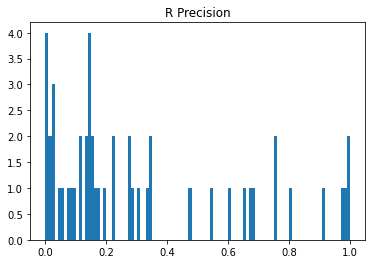

In [ ]:
plt.hist(r_prec,bins=100)
plt.title("R Precision")

Text(0.5, 1.0, 'R Precision Incorrect')

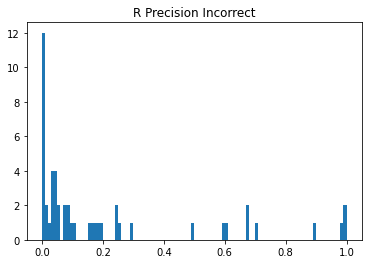

In [ ]:
plt.hist(r_prec_incorrect,bins=100)
plt.title("R Precision Incorrect")

Text(0.5, 1.0, 'Average Precision')

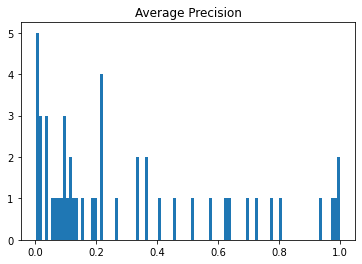

In [ ]:
plt.hist(avg_precisions,bins=100)
plt.title("Average Precision")

Text(0.5, 1.0, 'Discounted Cumulative Gain @ 10')

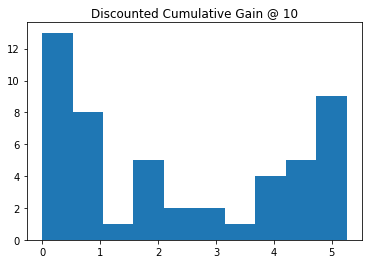

In [ ]:
plt.hist(dcg,bins=10)
plt.title("Discounted Cumulative Gain @ 10")

Text(0.5, 1.0, 'Normalized Discounted Cumulative Gain @ 10')

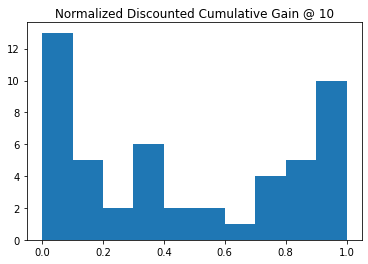

In [ ]:
plt.hist(ndcg,bins=10)
plt.title("Normalized Discounted Cumulative Gain @ 10")